<a href="https://colab.research.google.com/github/Parvathi-nair04/dsg-project/blob/main/endeval.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [14]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from matplotlib import pyplot as plt
from matplotlib import image as mpimg
import librosa
import librosa.display
import librosa.feature
from IPython.display import Audio


In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [15]:
df=pd.read_csv('/content/gdrive/MyDrive/ztgan/Data/features_30_sec.csv')
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


In [16]:
df.iloc[:,2:].describe()

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1.000000e+03,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.378682,0.086340,0.130930,0.003051,2201.780898,4.696916e+05,2242.541070,137079.155165,4571.549304,1.844345e+06,...,1.148144,60.730958,-3.966028,62.633624,0.507696,63.712586,-2.328761,66.231930,-1.095348,70.126096
std,0.081705,0.007735,0.065683,0.003634,715.960600,4.008995e+05,526.316473,96455.666326,1574.791602,1.425085e+06,...,4.578948,33.781951,4.549697,33.479172,3.869105,34.401977,3.755957,37.174631,3.837007,45.228512
min,0.171939,0.044555,0.005276,0.000004,570.040355,7.911251e+03,898.066208,10787.185064,749.140636,1.468612e+04,...,-15.693844,9.169314,-17.234728,13.931521,-11.963694,15.420555,-18.501955,13.487622,-19.929634,7.956583
25%,0.319562,0.082298,0.086657,0.000942,1627.697311,1.843505e+05,1907.240605,67376.554428,3380.069642,7.727312e+05,...,-1.863280,40.376442,-7.207225,40.830875,-2.007015,41.884240,-4.662925,41.710184,-3.368996,42.372865
50%,0.383148,0.086615,0.122443,0.001816,2209.263090,3.384862e+05,2221.392843,111977.548036,4658.524473,1.476115e+06,...,1.212809,52.325077,-4.065605,54.717674,0.669643,54.804890,-2.393862,57.423059,-1.166289,59.186117
75%,0.435942,0.091256,0.175682,0.003577,2691.294667,6.121479e+05,2578.469836,182371.576801,5533.810460,2.555262e+06,...,4.359662,71.691755,-0.838737,75.040838,3.119212,75.385832,0.150573,78.626444,1.312615,85.375374
max,0.663685,0.108111,0.397973,0.027679,4435.243901,3.036843e+06,3509.646417,694784.811549,8677.672688,8.660900e+06,...,13.457150,392.932373,11.482946,406.058868,15.388390,332.905426,14.694924,393.161987,15.369627,506.065155


Checking if any row has null values. All show False so none of the colums have null values

In [17]:
print(df.isnull())

     filename  length  chroma_stft_mean  chroma_stft_var  rms_mean  rms_var  \
0       False   False             False            False     False    False   
1       False   False             False            False     False    False   
2       False   False             False            False     False    False   
3       False   False             False            False     False    False   
4       False   False             False            False     False    False   
..        ...     ...               ...              ...       ...      ...   
995     False   False             False            False     False    False   
996     False   False             False            False     False    False   
997     False   False             False            False     False    False   
998     False   False             False            False     False    False   
999     False   False             False            False     False    False   

     spectral_centroid_mean  spectral_centroid_var 

Displaying the audios of first two audios of each genre

In [18]:
lst=["blues","classical","country","country","disco","hiphop", "jazz","metal", "pop", "reggae", "rock"]
for i in lst:
  print(i)
  data,sr=librosa.load("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00000.wav")
  data,sr=librosa.load("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00001.wav")
  display(Audio("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00000.wav"))
  display(Audio("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00001.wav"))



blues


classical


country


country


disco


hiphop


jazz


metal


pop


reggae


rock


Analyzing audiofiles using librosa and matplotlib functions

1.Plotting the waveform of first audio sample from each genre

<ipython-input-19-bbd64e37be17>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


<Figure size 720x432 with 0 Axes>

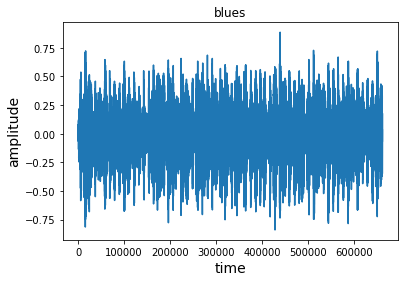

<Figure size 720x432 with 0 Axes>

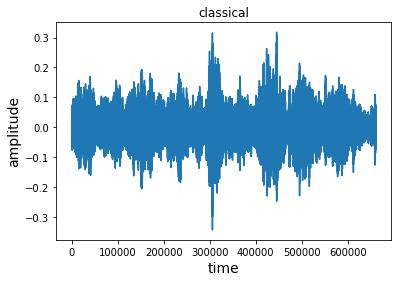

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

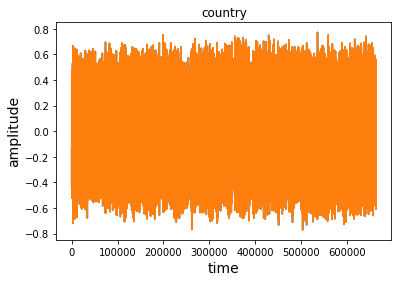

<Figure size 720x432 with 0 Axes>

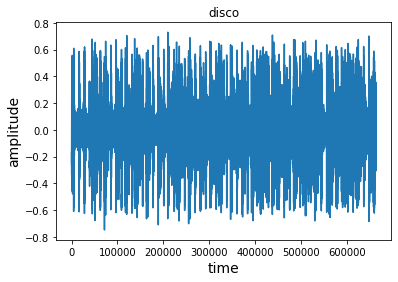

<Figure size 720x432 with 0 Axes>

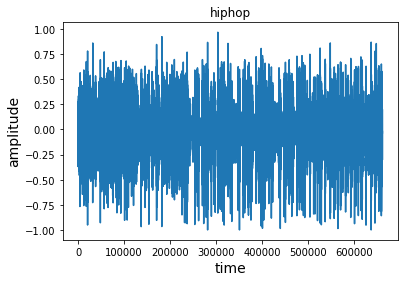

<Figure size 720x432 with 0 Axes>

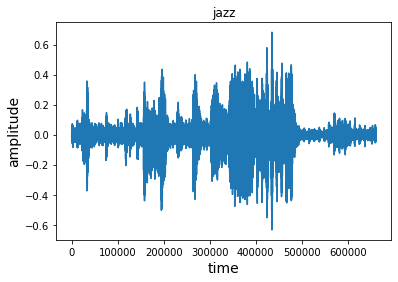

<Figure size 720x432 with 0 Axes>

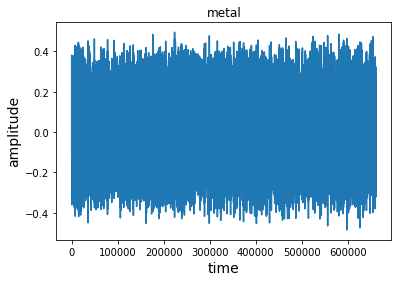

<Figure size 720x432 with 0 Axes>

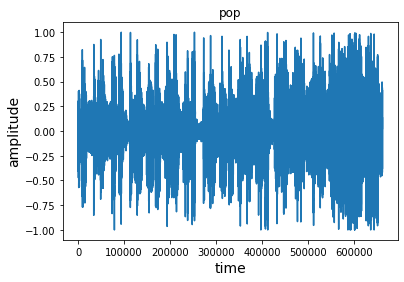

<Figure size 720x432 with 0 Axes>

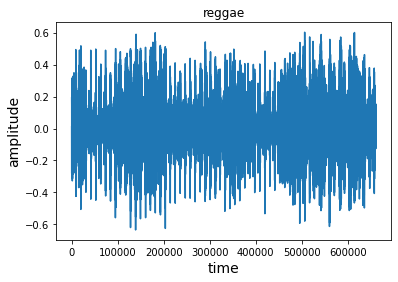

<Figure size 720x432 with 0 Axes>

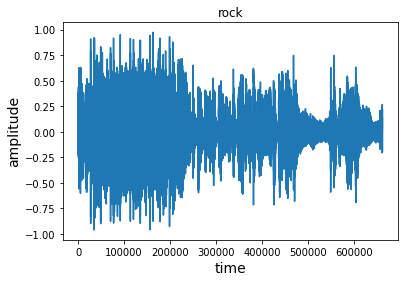

In [19]:
for i in lst:
  y,sr=librosa.load("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00000.wav")
  plt.figure(figsize=(10,6))
  plt.figure(i)
  plt.title(i)
  plt.xlabel("time", fontsize=14)
  plt.ylabel("amplitude", fontsize=14)
  plt.plot(y)
  

2.Plotting amplitude vs frequency graph of first audio of each genre

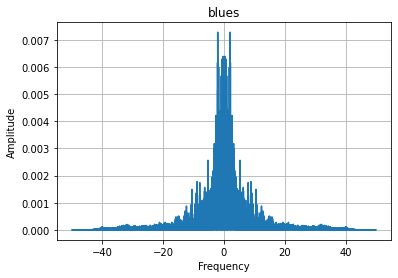

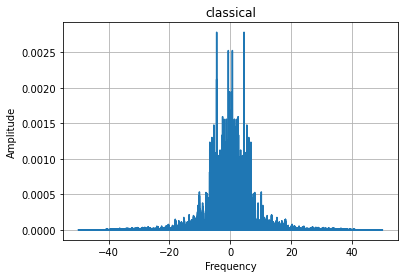

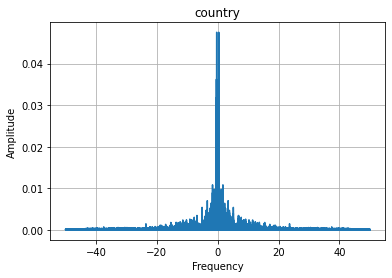

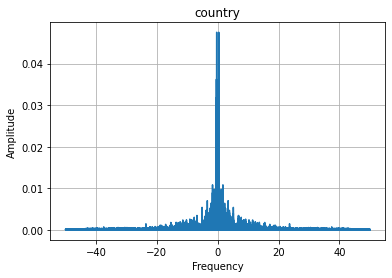

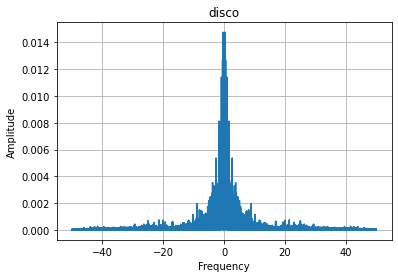

...

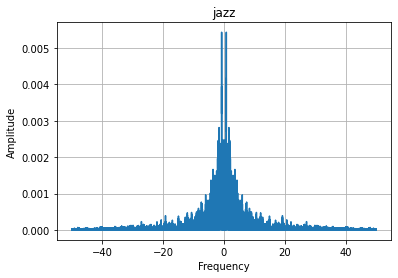

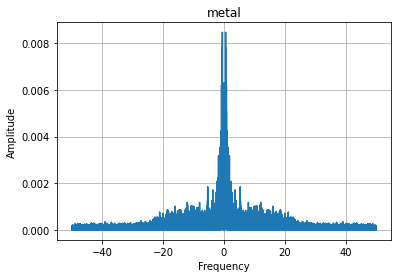

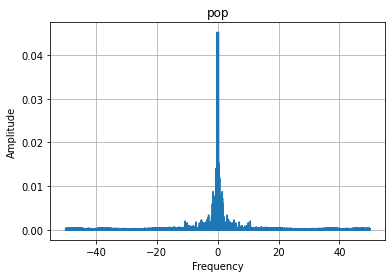

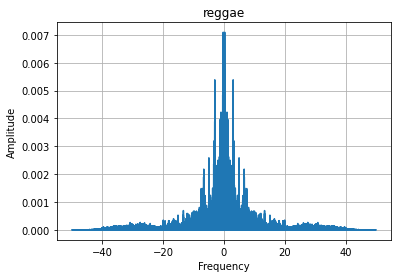

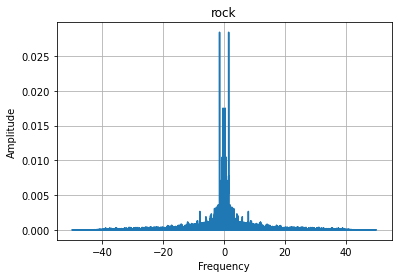

In [20]:
from scipy.fft import fft, fftfreq
for i in lst:
  y,sr=librosa.load("/content/gdrive/MyDrive/ztgan/Data/genres_original/" + i+"/" +i+".00000.wav")
  yf = fft(y)
  N=len(yf)
  xf = fftfreq(N, 0.01)
  plt.figure(i)
  plt.title(i)
  plt.xlabel("Frequency")
  plt.ylabel("Amplitude")
  plt.plot(xf, 2.0/N* np.abs(yf))
  plt.grid()
  plt.show()

Loading and displaying the images of spectrograms

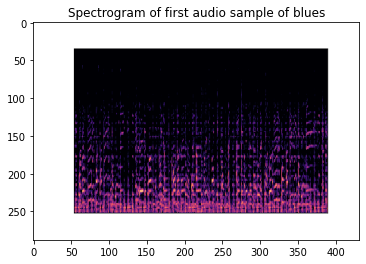

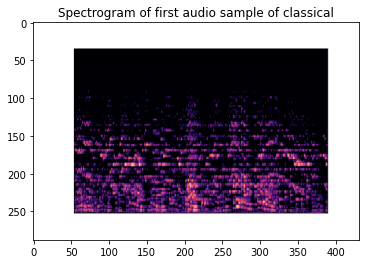

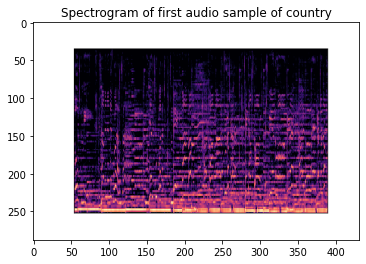

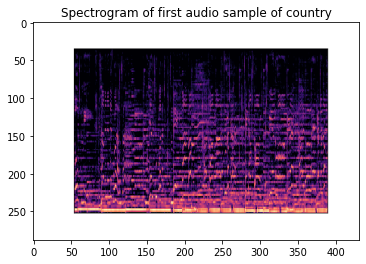

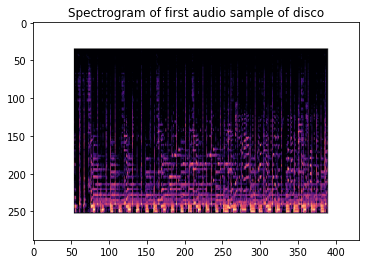

...

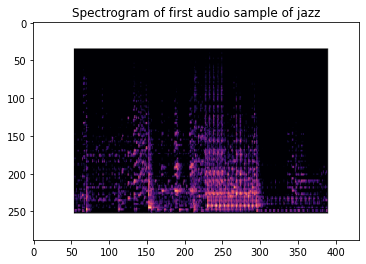

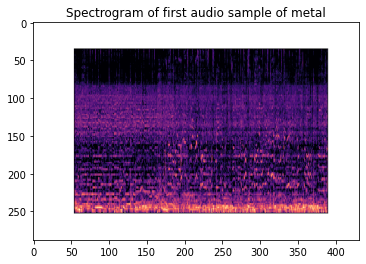

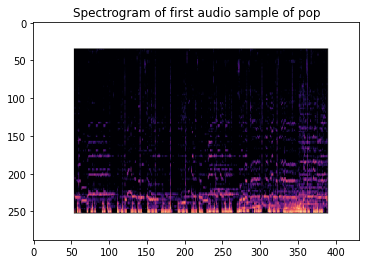

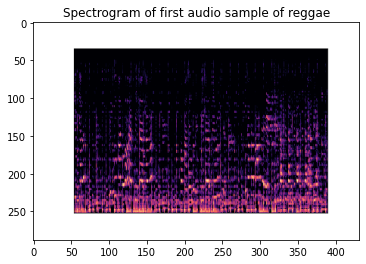

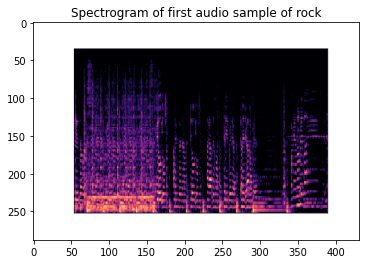

In [21]:
for i in lst:
  plt.title("Spectrogram of first audio sample of " +i)
  image = mpimg.imread("/content/gdrive/MyDrive/ztgan/Data/images_original/" +i+"/"+i+"00000.png")
  plt.imshow(image)
  plt.show()


CNN

In [4]:
batch_size = 64
num_classes = 10
learning_rate = 0.001
num_epochs = 20
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [8]:
all_transforms = transforms.Compose([transforms.Resize((32,32)),
                                     transforms.ToTensor(),
                                     transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],
                                                          std=[0.2023, 0.1994, 0.2010])
                                     ])
data_dir="/content/gdrive/MyDrive/ztgan/Data/images_original"
train_dataset = ImageFolder(data_dir, transform = all_transforms)
                                            


In [9]:
train_loader = torch.utils.data.DataLoader(dataset = train_dataset,
                                           batch_size = batch_size,
                                           shuffle = True)


In [10]:
# Creating a CNN class
class ConvNeuralNet(nn.Module):
	#  Determine what layers and their order in CNN object 
    def __init__(self, num_classes):
        super(ConvNeuralNet, self).__init__()
        self.conv_layer1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3)
        self.conv_layer2 = nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3)
        self.max_pool1 = nn.MaxPool2d(kernel_size = 2, stride = 2)
        
        self.conv_layer3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3)
        self.conv_layer4 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3)
        self.max_pool2 = nn.MaxPool2d(kernel_size = 2, stride = 2)
        
        self.fc1 = nn.Linear(1600, 128)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(128, num_classes)
    
    # Progresses data across layers    
    def forward(self, x):
        out = self.conv_layer1(x)
        out = self.conv_layer2(out)
        out = self.max_pool1(out)
        
        out = self.conv_layer3(out)
        out = self.conv_layer4(out)
        out = self.max_pool2(out)
                
        out = out.reshape(out.size(0), -1)
        
        out = self.fc1(out)
        out = self.relu1(out)
        out = self.fc2(out)
        return out


In [11]:
model = ConvNeuralNet(num_classes)

# Set Loss function with criterion
criterion = nn.CrossEntropyLoss()

# Set optimizer with optimizer
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate, weight_decay = 0.005, momentum = 0.9)  

total_step = len(train_loader)

In [12]:
for epoch in range(num_epochs):
	#Load in the data in batches using the train_loader object
    for i, (images, labels) in enumerate(train_loader):  
        # Move tensors to the configured device
        images = images.to(device)
        labels = labels.to(device)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)
        
        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    print('Epoch [{}/{}], Loss: {:.4f}'.format(epoch+1, num_epochs, loss.item()))

            
            

Epoch [1/20], Loss: 2.2980
Epoch [2/20], Loss: 2.2983
Epoch [3/20], Loss: 2.3011
Epoch [4/20], Loss: 2.3090
Epoch [5/20], Loss: 2.2847
Epoch [6/20], Loss: 2.3100
Epoch [7/20], Loss: 2.2764
Epoch [8/20], Loss: 2.2783
Epoch [9/20], Loss: 2.2632
Epoch [10/20], Loss: 2.2664
Epoch [11/20], Loss: 2.2557
Epoch [12/20], Loss: 2.2288
Epoch [13/20], Loss: 2.2141
Epoch [14/20], Loss: 2.1958
Epoch [15/20], Loss: 2.1500
Epoch [16/20], Loss: 2.0534
Epoch [17/20], Loss: 2.0482
Epoch [18/20], Loss: 2.0569
Epoch [19/20], Loss: 1.8557
Epoch [20/20], Loss: 2.1471


In [13]:
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    print('Accuracy of the network on the {} train images: {} %'.format(50000, 100 * correct / total))



Accuracy of the network on the 50000 train images: 28.855721393034827 %
